# Deze notebook kan paden vinden

Je hebt een volledige graaf nodig

In [1]:
from model_find_paths import connect_distribution_to_postnl
from model_plot_graph import plot_graph_on_folium, plot_uav_segments_with_legend, plot_polygons_static, plot_uav_corridors
from model_get_data import read_geojson
from model_evaluation import evaluate_alpha_tradeoff, plot_common_etypes_per_alpha, plot_pareto_tradeoff

import numpy as np

In [2]:
city = 'borsele'
depot = ['Goes']

In [3]:
import pickle
import networkx as nx

with open(f'/Users/cmartens/Documents/thesis_cf_martens/model/graph_creation/output/{city}.pkl', 'rb') as f:
    G = pickle.load(f)

In [4]:
gdf, lines_gdf, polygons_gdf, post_nl_gdf, no_fly_zones_gdf = read_geojson(f'/Users/cmartens/Documents/thesis_cf_martens/3.no_fly_zones/output/data_for_graph_{city}.geojson', depot, all=True)

Getting separate dataframes for lines, polygons, postnl points, distribution points and no fly zones
Looking for distribution points in ['Goes']
Found 1 distribution points in ['Goes']
Found 5309 lines, 4938 polygons, 24 postnl points, 1 distribution point and 6 no-fly zones


In [5]:
no_fly_zones_gdf

,name,id,description,area_type,category,risk,Height,air_type,geometry
10571,TRAUMAHELIKOPTER landingsplaats GOES/ Adrz,NaN,Vluchten in de OPEN categorie zijn hier niet t...,No-fly zone,Special Operations,no_fly_zone,NaN,Air Ambulance Landing Sites,"POLYGON ((53637.181 389447.667, 53637.091 3894..."
10572,Sloegebied (Vlissingen-Oost) Havengebied met r...,NaN,OPEN cat. vluchten zijn hier verboden SPEC cat...,No-fly zone,Industry,no_fly_zone,NaN,High-Risk Areas,"POLYGON ((40996.43 385892.928, 40981.46 385292..."
10573,Zeesteiger Zeeland Refinery Havengebied met ri...,NaN,OPEN cat. vluchten zijn hier verboden SPEC cat...,No-fly zone,Industry,no_fly_zone,NaN,High-Risk Areas,"POLYGON ((39745.895 381261.033, 39220.917 3816..."
10574,Gebied met verbod vanuit beveiligingsoverwegingen,NaN,OPEN cat. vluchten zijn hier verboden SPEC cat...,No-fly zone,Security,no_fly_zone,NaN,Restricted Zones,"POLYGON ((39393.122 383773.851, 39393.084 3837..."
10575,Gebied met verbod vanuit beveiligingsoverwegingen,NaN,OPEN cat. vluchten zijn hier verboden SPEC cat...,No-fly zone,Security,no_fly_zone,NaN,Restricted Zones,"POLYGON ((39145.428 384768.77, 39145.39 384762..."
10576,Natura 2000 Area Westerschelde & Saeftinghe,NaN,"Natura 2000-besluit 2010, wijzigingsbesluit 2012",No-fly zone,Environment,no_fly_zone,NaN,Protected Nature Reserves,"MULTIPOLYGON (((38488.379 384072.327, 38481.00..."


In [6]:
def plot_polygons_static(gdf_polygons, city_name="Unknown",
                         no_fly_zones_gdf=None, postnl_points=None, title=None, focus_radius_km=20):
    """
    Plot area-type polygons with consistent color coding on a static background map,
    including optional overlays for no-fly zones and PostNL/distribution points.

    Args:
        gdf_polygons (GeoDataFrame): Polygons with an 'area_type' column and EPSG:28992 CRS.
        city_name (str): Name of the city to use in the plot title.
        no_fly_zones_gdf (GeoDataFrame): Optional. Polygons representing no-fly zones.
        postnl_points (GeoDataFrame): Optional. Points with 'ntype' column: 'postnl' or 'distribution'.

    Returns:
        matplotlib.figure.Figure: The generated matplotlib figure.
    """

    import matplotlib.pyplot as plt
    from matplotlib.patches import Patch
    from matplotlib.lines import Line2D
    import contextily as ctx

    area_color_map = {
        # Infrastructuur
        'Motorways and major roads': '#E31A1C',       # felrood
        'Regional roads': '#F46D43',                  # vurig oranje
        'Tracks and rural access roads': '#D95F02',   # donkeroranje
        'Living and residential streets': '#FFCB05',  # felgeel
        'Pedestrian and cycling paths': '#66C2A5',    # turquoisegroen
        'Railways': '#4B4B4B',                        # donkergrijs
        'Helipads': '#F0027F',
        'Airports and airfields': '#A6CEE3',

        # Energie & communicatie
        'Power lines': '#999999',
        'Power plants': '#FF8C00',
        'Communication towers': '#FB9A99',
        'High infrastructures': '#888888',

        # Gebouwd gebied
        'Industrial zones': '#377EB8',               # helderblauw
        'Commercial zones': '#FFC300',               # goudgeel
        'Retail zones': '#FF8C00',                   # warm oranje
        'Residential areas': '#FFA07A',              # warm zalm/oranjerood – beter onderscheid met 'Retail zones'
        'Schools and universities': '#DAA520',
        'Hospitals': '#DC143C',
        'Care homes': '#FF9999',
        'Prisons': '#696969',
        'Religious sites': '#C71585',
        'Cemeteries': '#556B2F',
        'Cultural sites': '#8A2BE2',

        # Natuur
        'Parks': '#7CFC00',                          # limegroen
        'Recreational zones': '#20B2AA',
        'Meadows and open grass': '#9ACD32',         # geelgroen
        'Forests and woodlands': '#228B22',          # bosgroen
        'Agricultural lands': '#BFD92E',             # helderder dan '#ADDE87'
        'Wetlands': '#66B2FF',                       # licht, helder blauw
        'Lakes and ponds': '#1E90FF',                # diepblauw (meer contrast met 'Wetlands')
        'Water reservoirs': '#4682B4',
        'Rivers, canals and streams': '#5DADE2',
        'Natura2000 areas': '#005824',

        # Overig
        'connector': '#D3D3D3',
        'No-fly zone': '#B22222'
    }
    if gdf_polygons.empty:
        raise ValueError("GeoDataFrame is empty – no polygons to plot.")

    # Project to Web Mercator
    gdf_web = gdf_polygons.to_crs(epsg=3857)

    # Bereken middelpunt van alle polygonen
    centroid = gdf_web.unary_union.centroid
    x0, y0 = centroid.x, centroid.y

    # Zet radius om naar meters
    buffer_m = focus_radius_km * 1000

    # Stel bounds in: min/max x/y
    xlim = (x0 - buffer_m, x0 + buffer_m)
    ylim = (y0 - buffer_m, y0 + buffer_m)

    gdf_web["color"] = gdf_web["area_type"].map(area_color_map).fillna("#cccccc")

    if no_fly_zones_gdf is not None and not no_fly_zones_gdf.empty:
        # Filter expliciet op 'No-fly zone'
        no_fly_zones_filtered = no_fly_zones_gdf[no_fly_zones_gdf['area_type'] == 'No-fly zone']
        no_fly_zones_web = no_fly_zones_filtered.to_crs(epsg=3857)

    if postnl_points is not None:
        postnl_points_web = postnl_points.to_crs(epsg=3857)

    # Plot setup
    fig, ax = plt.subplots(figsize=(14, 12))
    gdf_web.plot(ax=ax, facecolor=gdf_web["color"], edgecolor='black', alpha=0.3, linewidth=0.5)

    if no_fly_zones_gdf is not None:
        no_fly_zones_web.plot(ax=ax, facecolor="#B22222", edgecolor='black', alpha=0.4, linewidth=0.7)

    # Plot PostNL & distribution points with scatter for better control
    if postnl_points is not None:
        if 'area_type' in postnl_points.columns:
            for area_type, group in postnl_points_web.groupby("area_type"):
                if area_type == "distribution":
                    ax.scatter(
                        group.geometry.x, group.geometry.y,
                        marker='o', s=150, c='green', edgecolors='black',
                        label='Distribution point', zorder=6
                    )
                elif area_type == "postnl point":
                    ax.scatter(
                        group.geometry.x, group.geometry.y,
                        marker='o', s=100, c='blue', edgecolors='black',
                        label='PostNL point', zorder=6
                    )
                else:
                    ax.scatter(
                        group.geometry.x, group.geometry.y,
                        marker='x', s=80, c='grey', edgecolors='black',
                        label=f'Other: {area_type}', zorder=6
                    )
        else:
            ax.scatter(
                postnl_points_web.geometry.x, postnl_points_web.geometry.y,
                marker='o', s=100, c='blue', edgecolors='black',
                label='PostNL points', zorder=6
            )

    # Basemap
    ax.set_xlim(xlim)
    ax.set_ylim(ylim)
    ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik, alpha=0.6, zoom=12)

    # Title and formatting
    ax.set_title(f"{title}", fontsize=16)
    ax.set_axis_off()

    # Legend
    used_types = gdf_web["area_type"].unique()
    legend_patches = [
        Patch(facecolor=color, edgecolor='black', label=atype)
        for atype, color in area_color_map.items()
        if atype in used_types
    ]

    if postnl_points is not None:
        legend_patches.append(Line2D([0], [0], marker='o', color='w', markerfacecolor='green',
                                     markeredgecolor='black', markersize=10, label='Distribution point'))
        legend_patches.append(Line2D([0], [0], marker='o', color='w', markerfacecolor='blue',
                                     markeredgecolor='black', markersize=10, label='PostNL point'))

    if no_fly_zones_gdf is not None and not no_fly_zones_gdf.empty:
        legend_patches.append(Patch(facecolor='#B22222', edgecolor='black', label='No-fly zone'))

    ax.legend(
        handles=legend_patches,
        title="Area Type",
        loc="upper left",
        bbox_to_anchor=(1.15, 1)
    )

    plt.tight_layout()
    return fig


/var/folders/3h/vvx1fk6x4knb13xtks19w_zh0000gp/T/ipykernel_5992/1282093988.py:75: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  centroid = gdf_web.unary_union.centroid


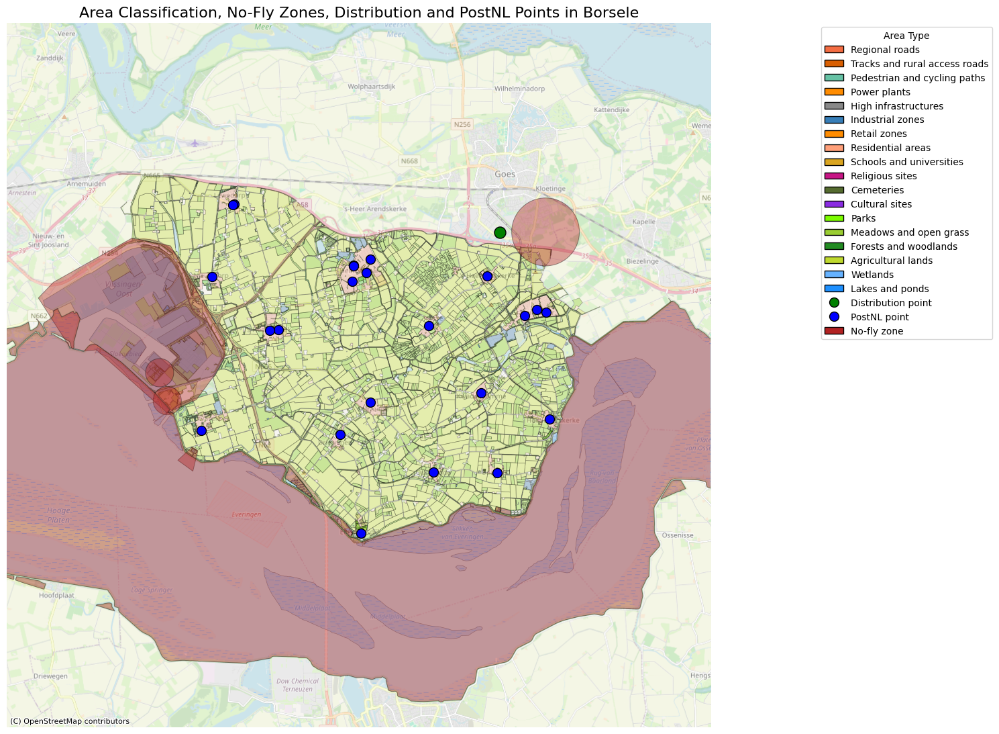

In [7]:
fig = plot_polygons_static(polygons_gdf, city_name=city, postnl_points=post_nl_gdf, title='Area Classification, No-Fly Zones, Distribution and PostNL Points in Borsele', no_fly_zones_gdf=no_fly_zones_gdf)
fig.savefig(f"output/map_{city}.pdf", dpi=300, bbox_inches="tight")

In [8]:
from shapely.geometry import Point, LineString
def connect_distribution_to_graph_manual(G, max_connection_distance=1000):
    """
    Connects 'distribution' nodes to their nearest edge of etype 'meadows and open grass'
    within a specified distance. A new waypoint node is inserted on the closest edge,
    which is split into two, and the original node is connected to this new waypoint.
    """

    edge_lines = []
    edge_keys = []

    # Collect all valid 'meadows and open grass' edges and their geometries
    for u, v, data in G.edges(data=True):
        if data.get("etype") != "Meadows and open grass":
            continue
        geom = data.get('geometry')
        if isinstance(geom, str):
            try: geom = wkt_loads(geom)
            except: continue
        if isinstance(geom, LineString):
            edge_lines.append(geom)
            edge_keys.append((u, v, data))

    print(f"Total filtered edges indexed: {len(edge_lines)}")

    connected = 0
    skipped = 0

    # Iterate over all distribution nodes
    print("Start iterating over distribution nodes.")
    for node_id, node_data in list(G.nodes(data=True)):
        if node_data.get("ntype") != "distribution":
            continue

        geom = node_data.get("geometry")
        if isinstance(geom, str):
            try: geom = wkt_loads(geom)
            except: continue
        if not isinstance(geom, Point):
            continue

        # Find the closest valid edge
        min_dist = float("inf")
        best_projection = None
        best_edge = None

        for line, (u, v, data) in zip(edge_lines, edge_keys):
            if not line.is_valid or line.is_empty or not geom.is_valid or geom.is_empty:
                continue

            proj_dist = line.project(geom)
            if np.isnan(proj_dist):
                continue

            proj = line.interpolate(proj_dist)
            dist = geom.distance(proj)
            if dist < min_dist:
                min_dist = dist
                best_projection = proj
                best_edge = (u, v, data, line)

        if min_dist > max_connection_distance or best_edge is None:
            print(f"Node {node_id} too far from any edge: {min_dist:.2f} m")
            skipped += 1
            continue

        u, v, edge_data, edge_geom = best_edge

        # Insert new node on the edge
        if G.has_edge(u, v):
            G.remove_edge(u, v)
        elif G.has_edge(v, u):
            G.remove_edge(v, u)
        else:
            print(f"⚠️ Edge ({u}, {v}) not found in graph. Skipping.")
            skipped += 1
            continue

        length_u = Point(G.nodes[u]['geometry']).distance(best_projection)
        length_v = Point(G.nodes[v]['geometry']).distance(best_projection)

        G.add_node(best_projection, geometry=best_projection, ntype='waypoint', inserted=True)

        G.add_edge(u, best_projection, geometry=LineString([G.nodes[u]['geometry'], best_projection]),
                   length=length_u, risk=edge_data.get('risk', 0), etype=edge_data.get('etype', 'split'))
        G.add_edge(best_projection, v, geometry=LineString([best_projection, G.nodes[v]['geometry']]),
                   length=length_v, risk=edge_data.get('risk', 0), etype=edge_data.get('etype', 'split'))

        # Connect the node to the new waypoint
        dist_to_projection = geom.distance(best_projection)
        G.add_edge(node_id, best_projection, geometry=LineString([geom, best_projection]),
                   length=dist_to_projection, risk=0, etype='postnl_connector', height=0)

        print(f"Node {node_id} connected to edge ({u}-{v}) via new node {best_projection} at d = {min_dist:.2f} m")
        connected += 1

    print(f"\n Summary of connections:")
    print(f" - Connected: {connected}")
    print(f" - Skipped: {skipped}")

    return G


In [9]:
G = connect_distribution_to_graph_manual(G, max_connection_distance=1000)

Total filtered edges indexed: 99165
Start iterating over distribution nodes.
Node 166248 connected to edge ((50741.964, 389045.451)-(50791.627, 389038.001)) via new node POINT (50761.28767423185 389042.5523017062) at d = 416.56 m

 Summary of connections:
 - Connected: 1
 - Skipped: 0


In [10]:
connected_1, not_connected = connect_distribution_to_postnl(G, 1, method='dijkstra')

Distribution points: 1
PostNL points: 23
Alpha: 1, Method: dijkstra
Connected: 166248 → 0 | Length: 13248.2 m | Cost: 257.30
Connected: 166248 → 1 | Length: 16396.8 m | Cost: 349.64
Connected: 166248 → 2 | Length: 14720.2 m | Cost: 304.37
Connected: 166248 → 3 | Length: 20848.9 m | Cost: 419.15
Connected: 166248 → 4 | Length: 6557.4 m | Cost: 262.35
No path: 5
Connected: 166248 → 6 | Length: 3203.4 m | Cost: 146.80
Connected: 166248 → 7 | Length: 11107.2 m | Cost: 313.15
Connected: 166248 → 8 | Length: 11448.6 m | Cost: 299.04
Connected: 166248 → 9 | Length: 15215.8 m | Cost: 312.83
Connected: 166248 → 10 | Length: 12893.5 m | Cost: 378.88
Connected: 166248 → 11 | Length: 21402.1 m | Cost: 489.30
Connected: 166248 → 12 | Length: 14615.4 m | Cost: 377.67
Connected: 166248 → 13 | Length: 16799.2 m | Cost: 361.98
Connected: 166248 → 14 | Length: 22745.8 m | Cost: 479.76
Connected: 166248 → 15 | Length: 7014.1 m | Cost: 182.14
Connected: 166248 → 16 | Length: 5523.6 m | Cost: 197.79
Connec

In [11]:
post_nl_gdf

,name,id,description,area_type,category,risk,Height,air_type,geometry,depotAbbreviation,depotCity
0,None,4.382965e+09,None,postnl point,PostNL,0.0,0.0,None,POINT (46054.432 388133.878),NaN,NaN
1,None,4.383861e+09,None,postnl point,PostNL,0.0,0.0,None,POINT (45610.295 388403.905),NaN,NaN
2,None,4.566915e+09,None,postnl point,PostNL,0.0,0.0,None,POINT (45008.857 382445.556),NaN,NaN
3,None,4.972314e+09,None,postnl point,PostNL,0.0,0.0,None,POINT (45669.098 378937.228),NaN,NaN
4,None,5.072491e+09,None,postnl point,PostNL,0.0,0.0,None,POINT (51639.794 386514.718),NaN,NaN
5,None,5.893600e+09,None,postnl point,PostNL,0.0,0.0,None,POINT (50030.177 383819.036),NaN,NaN
6,None,6.030034e+09,None,postnl point,PostNL,0.0,0.0,None,POINT (50325.966 387937.742),NaN,NaN
7,None,1.116974e+10,None,postnl point,PostNL,0.0,0.0,None,POINT (52433.778 382827.567),NaN,NaN
8,None,1.116974e+10,None,postnl point,PostNL,0.0,0.0,None,POINT (46087.224 383551.153),NaN,NaN
9,None,1.116974e+10,None,postnl point,PostNL,0.0,0.0,None,POINT (50535.631 380958.544),NaN,NaN


In [12]:
import folium
import pyproj
from shapely.geometry import Point, LineString, Polygon
from shapely.ops import transform
from shapely.wkt import loads as wkt_loads
import geopandas as gpd
import matplotlib.pyplot as plt
import contextily as ctx
from matplotlib.lines import Line2D

def plot_uav_segments_with_legend(connected_paths, city_name, title, postnl_points=None):
    import matplotlib.pyplot as plt
    import contextily as ctx
    from matplotlib.lines import Line2D
    """
    Plot a map of UAV corridor segments colored by edge type (etype), with a fixed, clear legend.

    Args:
        connected_paths (list): List of tuples containing route data, including path geometries and etype arrays.
        area_color_map (dict): Mapping of etype labels to HEX color codes.
        city_name (str): Name of the city to include in the plot title.

    Returns:
        matplotlib.figure.Figure: The generated plot figure object (for saving or displaying).
    """

    area_color_map = {
        # Infrastructuur
        'Motorways and major roads': '#E31A1C',       # felrood
        'Regional roads': '#F46D43',                  # vurig oranje
        'Tracks and rural access roads': '#D95F02',   # donkeroranje
        'Living and residential streets': '#FFCB05',  # felgeel
        'Pedestrian and cycling paths': '#66C2A5',    # turquoisegroen
        'Railways': '#4B4B4B',                        # donkergrijs
        'Helipads': '#F0027F',
        'Airports and airfields': '#A6CEE3',

        # Energie & communicatie
        'Power lines': '#999999',
        'Power plants': '#FF8C00',
        'Communication towers': '#FB9A99',
        'High infrastructures': '#888888',

        # Gebouwd gebied
        'Industrial zones': '#377EB8',               # helderblauw
        'Commercial zones': '#FFC300',               # goudgeel
        'Retail zones': '#FF8C00',                   # warm oranje
        'Residential areas': '#FFA07A',              # warm zalm/oranjerood – beter onderscheid met 'Retail zones'
        'Schools and universities': '#DAA520',
        'Hospitals': '#DC143C',
        'Care homes': '#FF9999',
        'Prisons': '#696969',
        'Religious sites': '#C71585',
        'Cemeteries': '#556B2F',
        'Cultural sites': '#8A2BE2',

        # Natuur
        'Parks': '#7CFC00',                          # limegroen
        'Recreational zones': '#20B2AA',
        'Meadows and open grass': '#9ACD32',         # geelgroen
        'Forests and woodlands': '#228B22',          # bosgroen
        'Agricultural lands': '#BFD92E',             # helderder dan '#ADDE87'
        'Wetlands': '#66B2FF',                       # licht, helder blauw
        'Lakes and ponds': '#1E90FF',                # diepblauw (meer contrast met 'Wetlands')
        'Water reservoirs': '#4682B4',
        'Rivers, canals and streams': '#5DADE2',
        'Natura2000 areas': '#005824',

        # Overig
        'connector': '#D3D3D3',
        'No-fly zone': '#B22222'
    }


    # Extract all valid LineStrings and their corresponding etypes
    segments = []
    etypes = []

    for _, _, _, _, path_geometries, etype_array in connected_paths:
        for (line_tuple, *_), etype in zip(path_geometries, etype_array):
            if isinstance(line_tuple, LineString):
                segments.append(line_tuple)
                etypes.append(etype)

    # Create GeoDataFrame from segments
    gdf_segments = gpd.GeoDataFrame({"etype": etypes}, geometry=segments, crs="EPSG:28992")
    print("Loaded segments:", len(gdf_segments))

    # Convert to Web Mercator
    gdf_web = gdf_segments.to_crs(epsg=3857)

    # Prepare plot
    fig, ax = plt.subplots(figsize=(20, 23), dpi=300)
    colors = gdf_web["etype"].map(area_color_map).fillna("#cccccc")
    gdf_web.plot(color=colors, ax=ax, linewidth=6, zorder=2)

    # Plot PostNL and distribution points
    if postnl_points is not None and not postnl_points.empty:
        if postnl_points.crs != "EPSG:28992":
            raise ValueError("postnl_points must use EPSG:28992 CRS")
        postnl_web = postnl_points.to_crs(epsg=3857)

        for area_type, group in postnl_web.groupby("area_type"):
            color = "blue" if area_type == "postnl point" else "green"
            label = "PostNL point" if area_type == "postnl point" else "Distribution point"
            ax.scatter(
                group.geometry.x,
                group.geometry.y,
                c=color,
                edgecolors="black",
                marker="o",
                s=100 if area_type == "postnl point" else 150,
                label=label,
                zorder=3
            )

    # Add basemap
    ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik, alpha=0.7, zorder=1)
    ax.set_axis_off()

    # Title
    if title == 1:
        ax.set_title(f"UAV corridor segments in {city_name} focussed on avoiding high-risk areas (alpha = 1)", fontsize=24)
    elif title == 0:
        ax.set_title(f"UAV corridor segments in {city_name} focussed on efficiency (alpha = 0)", fontsize=24)

    # Create legend
    legend_elements = [
        Line2D([0], [0], color=color, lw=5, label=etype)
        for etype, color in area_color_map.items()
        if etype in gdf_web["etype"].unique()
    ]

    if postnl_points is not None and not postnl_points.empty:
        legend_elements.append(Line2D([0], [0], marker='o', color='w', label='PostNL point',
                                      markerfacecolor='blue', markeredgecolor='black', markersize=10))
        legend_elements.append(Line2D([0], [0], marker='o', color='w', label='Distribution point',
                                      markerfacecolor='green', markeredgecolor='black', markersize=12))

    ax.legend(
        handles=legend_elements,
        title="Corridor Segment Types",
        loc="upper left",
        bbox_to_anchor=(1.15, 1),
        title_fontsize=20,
        fontsize=18
    )

    plt.tight_layout()
    return fig

Loaded segments: 9708


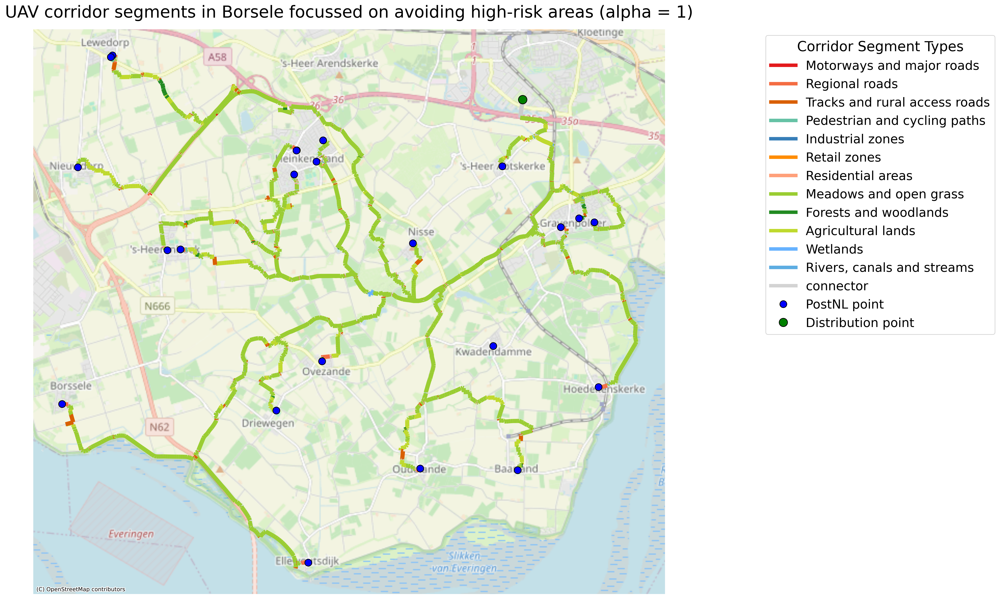

In [25]:
fig = plot_uav_segments_with_legend(connected_1, city_name='Borsele', title=1, postnl_points=post_nl_gdf)
fig.savefig(f"output/{city}_uav_segments_alpha_1.pdf", dpi=300, bbox_inches="tight")

In [14]:
connected_0, not_connected = connect_distribution_to_postnl(G, 0, method='dijkstra')

Distribution points: 1
PostNL points: 23
Alpha: 0, Method: dijkstra
Connected: 166248 → 0 | Length: 6510.3 m | Cost: 168.68
Connected: 166248 → 1 | Length: 7055.2 m | Cost: 180.27
Connected: 166248 → 2 | Length: 11041.0 m | Cost: 277.88
Connected: 166248 → 3 | Length: 14150.3 m | Cost: 359.68
Connected: 166248 → 4 | Length: 4048.1 m | Cost: 107.12
No path: 5
Connected: 166248 → 6 | Length: 2210.5 m | Cost: 57.12
Connected: 166248 → 7 | Length: 8102.8 m | Cost: 204.43
Connected: 166248 → 8 | Length: 9426.1 m | Cost: 237.51
Connected: 166248 → 9 | Length: 10194.8 m | Cost: 258.76
Connected: 166248 → 10 | Length: 10362.2 m | Cost: 260.92
Connected: 166248 → 11 | Length: 15099.4 m | Cost: 381.38
Connected: 166248 → 12 | Length: 10925.6 m | Cost: 277.03
Connected: 166248 → 13 | Length: 11084.4 m | Cost: 283.03
Connected: 166248 → 14 | Length: 12896.8 m | Cost: 328.34
Connected: 166248 → 15 | Length: 4295.8 m | Cost: 111.28
Connected: 166248 → 16 | Length: 4018.3 m | Cost: 104.35
Connected: 

Loaded segments: 5256


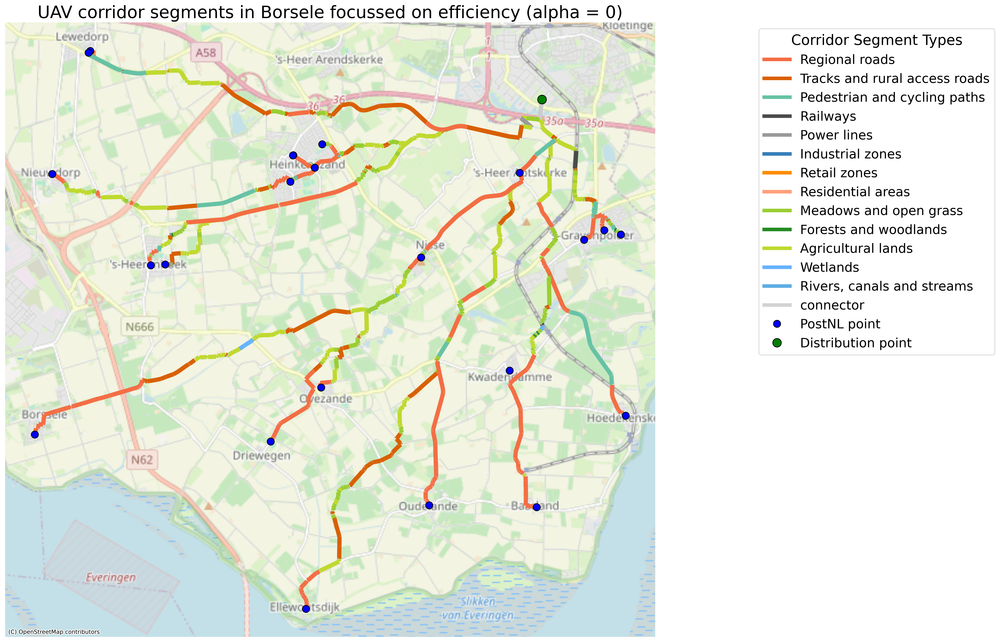

In [15]:
fig = plot_uav_segments_with_legend(connected_0, city_name='Borsele', title=0, postnl_points=post_nl_gdf)
fig.savefig(f"output/{city}_uav_segments_alpha_0.pdf", dpi=300, bbox_inches="tight")

In [16]:
df_summary, all_etypes, etype_dict_per_alpha = evaluate_alpha_tradeoff(G,np.linspace(0, 1, 11), method='dijkstra')

Distribution points: 1
PostNL points: 23
Alpha: 0.0, Method: dijkstra
Connected: 166248 → 0 | Length: 6510.3 m | Cost: 168.68
Connected: 166248 → 1 | Length: 7055.2 m | Cost: 180.27
Connected: 166248 → 2 | Length: 11041.0 m | Cost: 277.88
Connected: 166248 → 3 | Length: 14150.3 m | Cost: 359.68
Connected: 166248 → 4 | Length: 4048.1 m | Cost: 107.12
No path: 5
Connected: 166248 → 6 | Length: 2210.5 m | Cost: 57.12
Connected: 166248 → 7 | Length: 8102.8 m | Cost: 204.43
Connected: 166248 → 8 | Length: 9426.1 m | Cost: 237.51
Connected: 166248 → 9 | Length: 10194.8 m | Cost: 258.76
Connected: 166248 → 10 | Length: 10362.2 m | Cost: 260.92
Connected: 166248 → 11 | Length: 15099.4 m | Cost: 381.38
Connected: 166248 → 12 | Length: 10925.6 m | Cost: 277.03
Connected: 166248 → 13 | Length: 11084.4 m | Cost: 283.03
Connected: 166248 → 14 | Length: 12896.8 m | Cost: 328.34
Connected: 166248 → 15 | Length: 4295.8 m | Cost: 111.28
Connected: 166248 → 16 | Length: 4018.3 m | Cost: 104.35
Connected

In [30]:
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
from matplotlib.lines import Line2D
import numpy as np

def plot_pareto_tradeoff1(df_summary, x_metric="mean_risk", y_metric="mean_energy"):
    """
    Plot Pareto frontier for trade-off between risk and energy with per-alpha color-coded legend.

    Args:
        df_summary (pd.DataFrame): DataFrame from evaluate_alpha_tradeoff.
        x_metric (str): Column name for x-axis (e.g., "mean_risk").
        y_metric (str): Column name for y-axis (e.g., "mean_energy").
    """
    fig = plt.figure(figsize=(8, 6))

    # Create color mapping
    cmap = cm.get_cmap("viridis")
    norm = mcolors.Normalize(vmin=min(df_summary["alpha"]), vmax=max(df_summary["alpha"]))
    alpha_colors = {alpha: cmap(norm(alpha)) for alpha in df_summary["alpha"]}

    # Plot each point individually with its alpha color
    for _, row in df_summary.iterrows():
        plt.scatter(
            row[x_metric],
            row[y_metric],
            color=alpha_colors[row["alpha"]],
            s=100
        )
        plt.text(
            row[x_metric] + 0.01,
            row[y_metric],
            f"α = {row['alpha']:.2f}",
            fontsize=9,
            ha='left',
            va='top'
        )

    # Create legend handles
    legend_elements = [
        Line2D([0], [0], marker='o', color='w', label=f"α = {alpha:.2f}",
               markerfacecolor=color, markersize=10)
        for alpha, color in alpha_colors.items()
    ]

    plt.legend(handles=legend_elements, title="Alpha (α)", loc='upper right', bbox_to_anchor=(1.25, 1))
    plt.xlabel("Average Total Risk per Path")
    plt.ylabel("Average Total Energy per Path")
    plt.title("Pareto Trade-off: Risk vs Energy (per α) for Borsele")
    plt.grid(True)
    plt.tight_layout()
    plt.show()
    return fig

/var/folders/3h/vvx1fk6x4knb13xtks19w_zh0000gp/T/ipykernel_5992/329564233.py:19: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap("viridis")


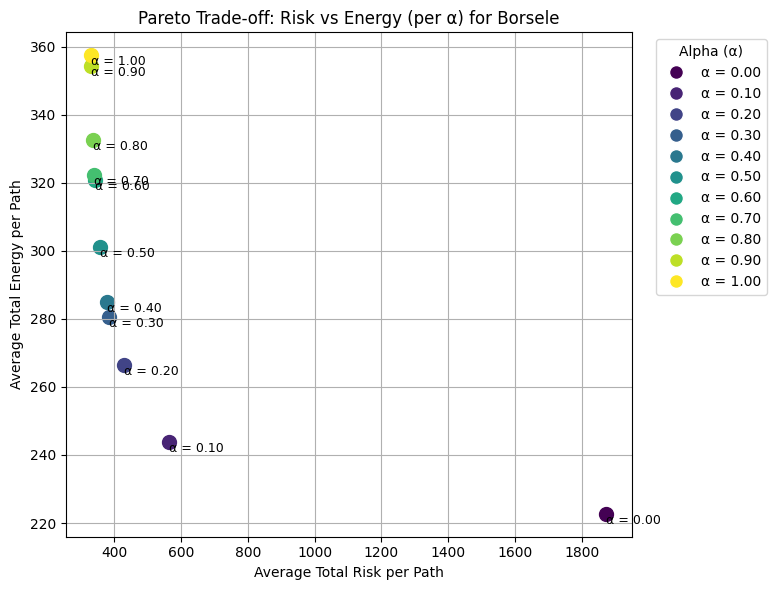

In [31]:
fig_pareto = plot_pareto_tradeoff1(df_summary)
fig_pareto.savefig(f"output/pareto_tradeoff_borsele.pdf", dpi=300, bbox_inches="tight")

In [20]:
import folium
import pyproj
from shapely.geometry import Point, LineString, Polygon
from shapely.ops import transform
from shapely.wkt import loads as wkt_loads
import geopandas as gpd
import matplotlib.pyplot as plt
import contextily as ctx
from matplotlib.lines import Line2D
import geopandas as gpd
import matplotlib.pyplot as plt
import contextily as ctx
from matplotlib.patches import Patch
from collections import Counter
import pandas as pd
import seaborn as sns

def plot_common_etypes_per_alpha(etype_dict_per_alpha, city="Unknown", title_prefix="Most Common Etypes in"):
    """
    Creates one bar plot per alpha, showing the frequency of etypes.
    Ensures the same y-axis scale across all plots for comparison.

    Args:
        etype_dict_per_alpha (dict): Dictionary where keys are alpha values and values are lists of etypes.
        title_prefix (str): Title prefix to display before the alpha value.
    """

    area_color_map = {
        # Infrastructuur
        'Motorways and major roads': '#E31A1C',       # felrood
        'Regional roads': '#F46D43',                  # vurig oranje
        'Tracks and rural access roads': '#D95F02',   # donkeroranje
        'Living and residential streets': '#FFCB05',  # felgeel
        'Pedestrian and cycling paths': '#66C2A5',    # turquoisegroen
        'Railways': '#4B4B4B',                        # donkergrijs
        'Helipads': '#F0027F',
        'Airports and airfields': '#A6CEE3',

        # Energie & communicatie
        'Power lines': '#999999',
        'Power plants': '#FF8C00',
        'Communication towers': '#FB9A99',
        'High infrastructures': '#888888',

        # Gebouwd gebied
        'Industrial zones': '#377EB8',               # helderblauw
        'Commercial zones': '#FFC300',               # goudgeel
        'Retail zones': '#FF8C00',                   # warm oranje
        'Residential areas': '#FFA07A',              # warm zalm/oranjerood – beter onderscheid met 'Retail zones'
        'Schools and universities': '#DAA520',
        'Hospitals': '#DC143C',
        'Care homes': '#FF9999',
        'Prisons': '#696969',
        'Religious sites': '#C71585',
        'Cemeteries': '#556B2F',
        'Cultural sites': '#8A2BE2',

        # Natuur
        'Parks': '#7CFC00',                          # limegroen
        'Recreational zones': '#20B2AA',
        'Meadows and open grass': '#9ACD32',         # geelgroen
        'Forests and woodlands': '#228B22',          # bosgroen
        'Agricultural lands': '#BFD92E',             # helderder dan '#ADDE87'
        'Wetlands': '#66B2FF',                       # licht, helder blauw
        'Lakes and ponds': '#1E90FF',                # diepblauw (meer contrast met 'Wetlands')
        'Water reservoirs': '#4682B4',
        'Rivers, canals and streams': '#5DADE2',
        'Natura2000 areas': '#005824',

        # Overig
        'connector': '#D3D3D3',
        'No-fly zone': '#B22222'
    }
    all_etypes = sorted(set(et for etypes in etype_dict_per_alpha.values() for et in etypes))
    global_max = max((Counter(ets).most_common(1)[0][1] if ets else 0) for ets in etype_dict_per_alpha.values())

    for alpha, etypes in etype_dict_per_alpha.items():
        counts = Counter(etypes)
        etype_df = pd.DataFrame({
            "etype": all_etypes,
            "count": [counts.get(e, 0) for e in all_etypes]
        })

        plt.figure(figsize=(12, 5))
        colors = [area_color_map.get(e, "#cccccc") for e in etype_df["etype"]]
        sns.barplot(data=etype_df, x="etype", y="count", palette=colors)
        plt.ylim(0, global_max * 1.1)
        plt.xticks(rotation=45, ha='right')
        plt.xlabel("Edge type (etype)")
        plt.ylabel("Total count")
        plt.title(f"{title_prefix} {city} (α = {alpha:.2f})")
        plt.tight_layout()
        plt.show()


/var/folders/3h/vvx1fk6x4knb13xtks19w_zh0000gp/T/ipykernel_5992/142096292.py:86: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=etype_df, x="etype", y="count", palette=colors)


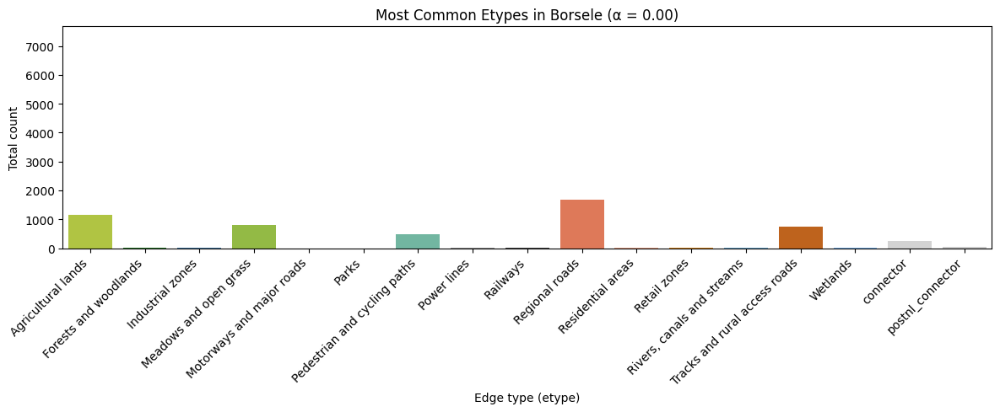

/var/folders/3h/vvx1fk6x4knb13xtks19w_zh0000gp/T/ipykernel_5992/142096292.py:86: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=etype_df, x="etype", y="count", palette=colors)


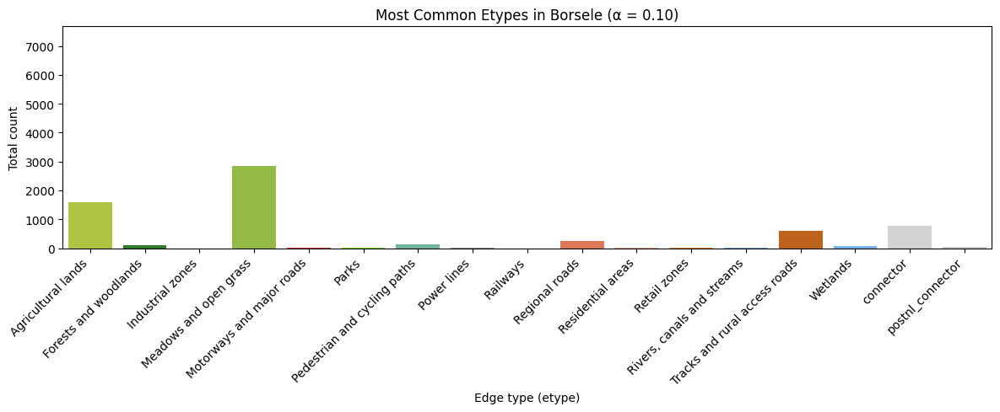

/var/folders/3h/vvx1fk6x4knb13xtks19w_zh0000gp/T/ipykernel_5992/142096292.py:86: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=etype_df, x="etype", y="count", palette=colors)


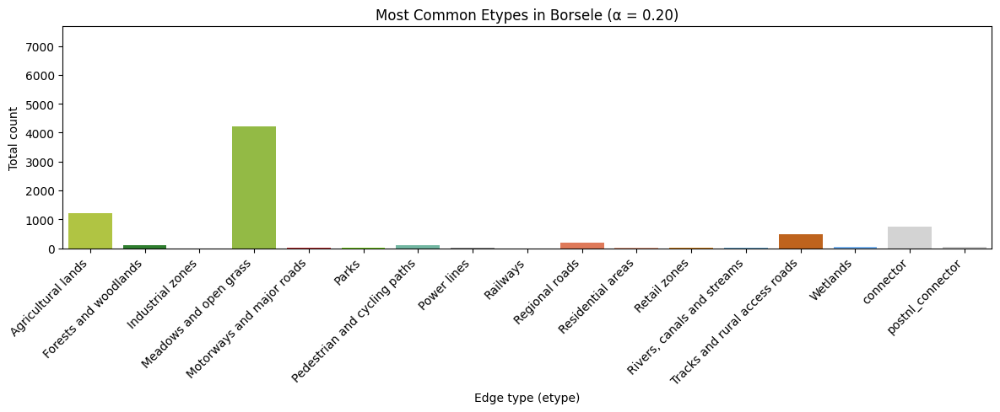

/var/folders/3h/vvx1fk6x4knb13xtks19w_zh0000gp/T/ipykernel_5992/142096292.py:86: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=etype_df, x="etype", y="count", palette=colors)


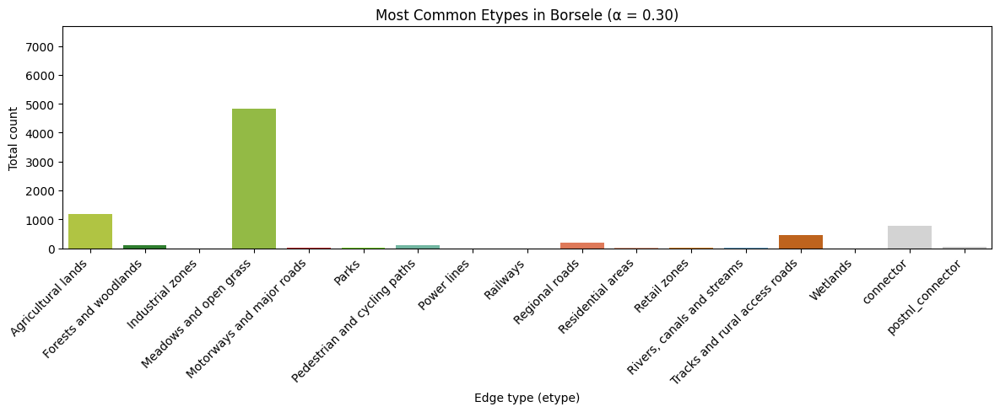

/var/folders/3h/vvx1fk6x4knb13xtks19w_zh0000gp/T/ipykernel_5992/142096292.py:86: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=etype_df, x="etype", y="count", palette=colors)


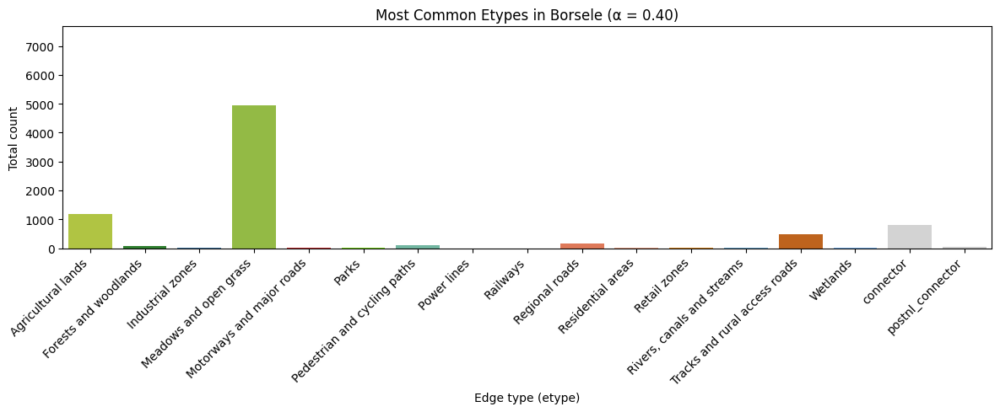

/var/folders/3h/vvx1fk6x4knb13xtks19w_zh0000gp/T/ipykernel_5992/142096292.py:86: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=etype_df, x="etype", y="count", palette=colors)


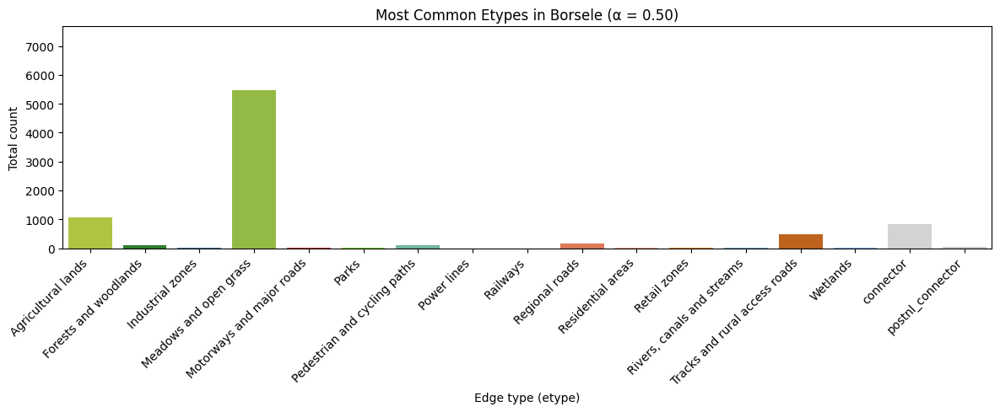

/var/folders/3h/vvx1fk6x4knb13xtks19w_zh0000gp/T/ipykernel_5992/142096292.py:86: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=etype_df, x="etype", y="count", palette=colors)


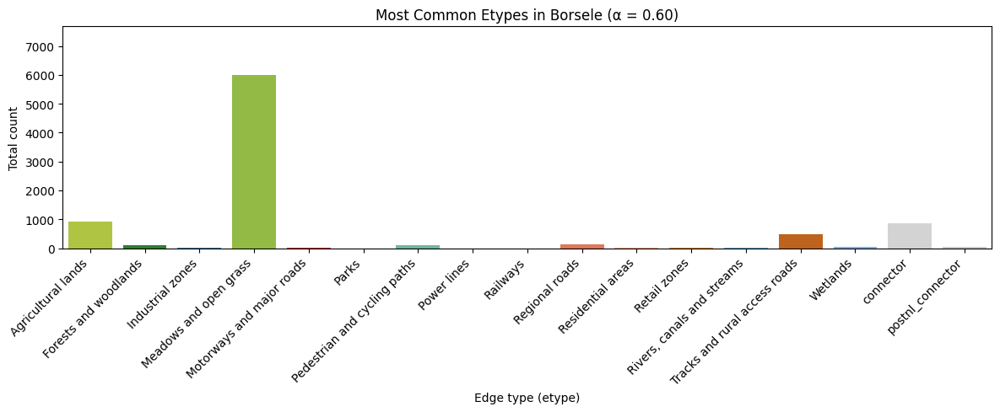

/var/folders/3h/vvx1fk6x4knb13xtks19w_zh0000gp/T/ipykernel_5992/142096292.py:86: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=etype_df, x="etype", y="count", palette=colors)


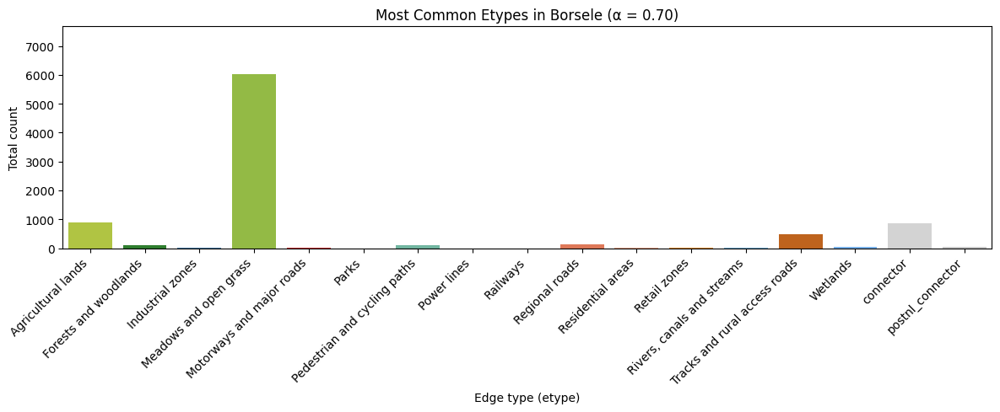

/var/folders/3h/vvx1fk6x4knb13xtks19w_zh0000gp/T/ipykernel_5992/142096292.py:86: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=etype_df, x="etype", y="count", palette=colors)


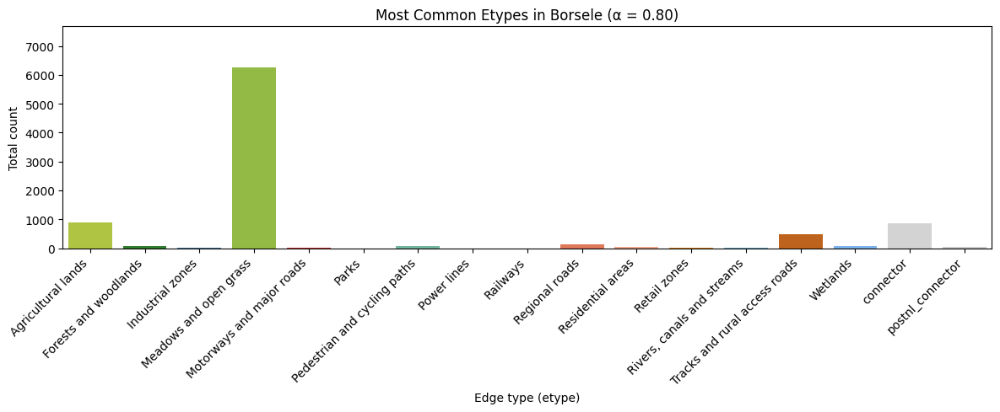

/var/folders/3h/vvx1fk6x4knb13xtks19w_zh0000gp/T/ipykernel_5992/142096292.py:86: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=etype_df, x="etype", y="count", palette=colors)


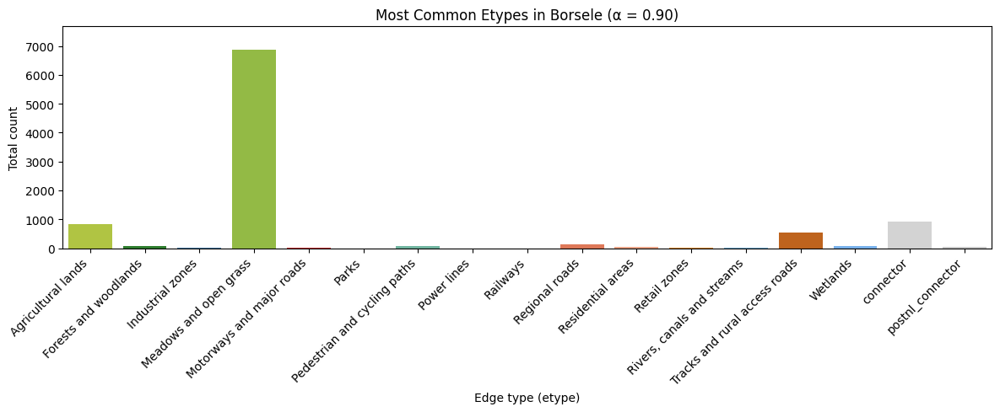

/var/folders/3h/vvx1fk6x4knb13xtks19w_zh0000gp/T/ipykernel_5992/142096292.py:86: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=etype_df, x="etype", y="count", palette=colors)


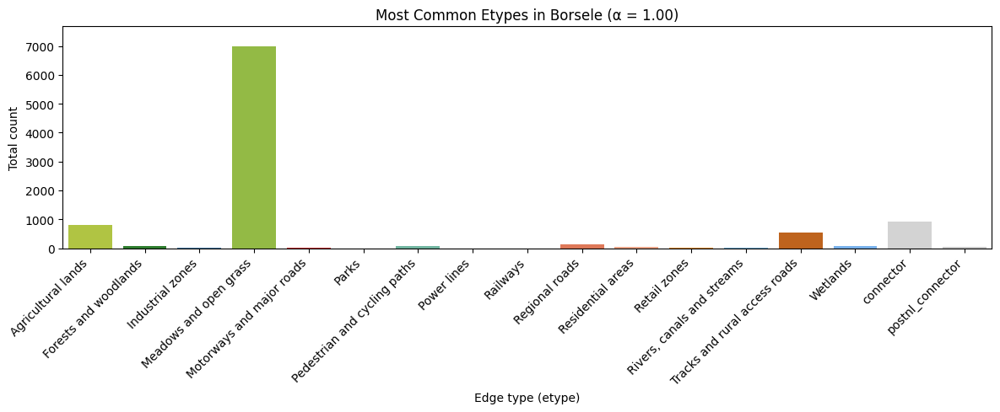

In [21]:
plot_common_etypes_per_alpha(etype_dict_per_alpha, city='Borsele')

In [23]:
cols = ["alpha", "mean_risk", "mean_energy", "mean_cost", "mean_length", "max_length", "min_length", "avg_steps", "n_unique_etypes"]
df_latex = df_summary[cols]

with open("output/alphen_waddinxveen_sum.tex", "w") as f:
    f.write(df_latex.to_latex(index=False, float_format="%.3f",
                               caption="Summary of UAV corridor paths in Alphen aan den Rijn and Waddinxveen",
                               label="tab:alphen_waddinxveen_summary",
                               column_format="lcccccccc"))


In [24]:
df_latex

,alpha,mean_risk,mean_energy,mean_cost,mean_length,max_length,min_length,avg_steps,n_unique_etypes
0,0.0,1872.681384,222.707741,222.707741,8748.842958,15099.416884,2210.459067,247.285714,15
1,0.1,564.307333,243.738332,275.795232,9559.133293,16373.592934,2317.770347,304.333333,15
2,0.2,430.663901,266.319388,299.188291,10477.842201,18609.971375,2434.364380,338.142857,15
3,0.3,385.102140,280.515246,311.891314,11053.409839,18735.283238,2701.710470,363.095238,13
4,0.4,377.485125,284.858509,321.909155,11231.007020,18989.900931,2879.762589,370.380952,15
5,0.5,358.327022,301.046610,329.686816,11851.464409,20176.578950,2983.455284,393.238095,15
6,0.6,341.597529,320.885865,333.312863,12645.034591,21150.970724,3069.612260,413.142857,14
7,0.7,340.798423,322.287915,335.245270,12701.116583,21166.656695,3069.612260,412.285714,14
8,0.8,337.510817,332.689882,336.546630,13109.461957,21263.825745,3069.612260,422.904762,14
9,0.9,332.350843,354.249884,334.540747,13971.862033,22662.296803,3203.363907,453.571429,14
